# Análise de acidentes em rodovias federais entre 2017 e 2020 

Dados disponíveis em: https://portal.prf.gov.br/dados-abertos-acidentes

### Importação das bibliotecas de tratamento, visualização e transformação dos dados

In [1]:
#Importação da Biblioteca Pandas e NumPy para análise dos dados
'''Tratamento de dados'''
import pandas as pd
import numpy as np
'''Plotagem de Dados'''
import matplotlib.pyplot as plt
import plotly.offline as py
import plotly.graph_objects as go
import seaborn as sns
'''Enriquecimento de Dados'''
import twint
import nest_asyncio
'''Dados Cartográficos'''
from folium.plugins import HeatMap
import folium
'''Nuvem de Palavras'''
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from PIL import Image
'''Machine Learning'''
from sklearn import tree
from sklearn.compose import make_column_transformer, make_column_selector
from sklearn.impute import SimpleImputer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn import svm
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
import warnings
from sklearn.metrics import plot_confusion_matrix, precision_score, recall_score, f1_score, classification_report, accuracy_score
from sklearn import tree
from sklearn import svm
from sklearn.tree import DecisionTreeClassifier
from imblearn.over_sampling import SMOTE
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_classif
%matplotlib inline
!pip install wordcloud -q
warnings.filterwarnings('ignore')

# Importação, organização e tratamento dos dados

### Importação dos dados da PRF

In [2]:
#Importação dos dados de 2017 a 2020 utilizando a biblioteca Pandas
df_2017 = pd.read_csv('C:/Users/valde/OneDrive/TCC PUC/dados_prf/acidentes2017.csv', sep=';', encoding='cp1252', low_memory=False)
df_2018 = pd.read_csv('C:/Users/valde/OneDrive/TCC PUC/dados_prf/acidentes2018.csv', sep=';', encoding='cp1252', low_memory=False)
df_2019 = pd.read_csv('C:/Users/valde/OneDrive/TCC PUC/dados_prf/acidentes2019.csv', sep=';', encoding='cp1252', low_memory=False)
df_2020 = pd.read_csv('C:/Users/valde/OneDrive/TCC PUC/dados_prf/acidentes2020.csv', sep=';', encoding='cp1252', low_memory=False)

### Junção dos datasets em um único arquivo

In [3]:
frames = [df_2017, df_2018, df_2019, df_2020]

In [4]:
acidentes = pd.concat(frames)
acidentes.reset_index(inplace=True, drop=True)

### Visualização do Dataframe

In [5]:
acidentes.head(10)

,id,pesid,data_inversa,dia_semana,horario,uf,br,km,municipio,causa_acidente,...,sexo,ilesos,feridos_leves,feridos_graves,mortos,latitude,longitude,regional,delegacia,uop
0,8.0,1.0,2017-01-01,domingo,00:00:00,PR,376.0,112,PARANAVAI,Fenômenos da Natureza,...,Masculino,0,0,1,0,"-23,09880731","-52,38789369",SR-PR,DEL7/7,UOP05/PR
1,9.0,955.0,2017-01-01,domingo,00:01:00,SC,101.0,234,PALHOCA,Falta de Atenção à Condução,...,Masculino,1,0,0,0,"-27,8101","-48,6357",SR-SC,DEL8/1,UOP02/SC
2,11.0,3.0,2017-01-01,domingo,00:00:00,PR,153.0,"56,9",SANTO ANTONIO DA PLATINA,Animais na Pista,...,Masculino,0,1,0,0,"-23,36951985","309,93513107",SR-PR,DEL7/7,UOP07/PR
3,11.0,2.0,2017-01-01,domingo,00:00:00,PR,153.0,"56,9",SANTO ANTONIO DA PLATINA,Animais na Pista,...,Feminino,0,1,0,0,"-23,36951985","309,93513107",SR-PR,DEL7/7,UOP07/PR
4,12.0,1499.0,2017-01-01,domingo,00:00:00,GO,153.0,435,ANAPOLIS,Avarias e/ou desgaste excessivo no pneu,...,Masculino,0,0,1,0,"-16,27473677","-48,96908998",SR-GO,DEL1/2,UOP01/GO
5,13.0,1892.0,2017-01-01,domingo,00:00:00,SC,280.0,"77,3",CORUPA,Ingestão de Álcool,...,Masculino,0,1,0,0,"-26,44675249","-49,20166969",SR-SC,DEL8/6,UOP03/SC
6,14.0,1563.0,2017-01-01,domingo,00:40:00,GO,60.0,188,GUAPO,Falta de Atenção à Condução,...,Masculino,0,1,0,0,"-16,82489647","-49,53520775",SR-GO,DEL1/1,UOP02/GO
7,14.0,1558.0,2017-01-01,domingo,00:40:00,GO,60.0,188,GUAPO,Falta de Atenção à Condução,...,Masculino,1,0,0,0,"-16,82489647","-49,53520775",SR-GO,DEL1/1,UOP02/GO
8,15.0,555.0,2017-01-01,domingo,00:01:00,PB,104.0,"3,4",NOVA FLORESTA,Ingestão de Álcool,...,Masculino,0,0,0,1,"-6,4622","-36,1899",SR-PB,DEL14/2,UOP04/PB
9,16.0,990.0,2017-01-01,domingo,00:30:00,TO,153.0,"141,7",ARAGUAINA,Ingestão de Álcool,...,Masculino,0,1,0,0,"-7,18668515","-48,22970957",SR-TO,UOP04/TO,NaN


#### Verificação do shape do dataset

In [6]:
acidentes.shape

(678942, 35)

### Limpeza dos dados na base (Data Cleaning or Data Cleansing)

As colunas da lista abaixo, foram removidas com o objetivo de iniciar uma limpeza geral da base. Alguns dados como id, delegacia e uop (unidade operacional) foram removidas, e a coluna Mortos, reposicionada para ser posteriormente utilizada como classe alvo do modelo de ML.

In [7]:
acidentes = acidentes.drop(columns=['marca', 'ano_fabricacao_veiculo', 'regional', 'delegacia', 'uop', 'id', 'pesid', 'id_veiculo', 'sentido_via', 'estado_fisico'])

### Organização do dataset

A coluna contendo a classe alvo foi inserida na última posição do dataset, com o objetivo de facilitar 
o processo de divisão dos dados nas próximas etapas.

In [8]:
colunas = ['data_inversa', 'dia_semana', 'horario', 'uf', 'br', 'km', 'municipio',
       'causa_acidente', 'tipo_acidente', 'classificacao_acidente', 'fase_dia',
       'condicao_metereologica', 'tipo_pista', 'tracado_via', 'uso_solo',
       'tipo_veiculo', 'tipo_envolvido', 'idade', 'sexo',
       'ilesos', 'feridos_leves', 'feridos_graves',  'latitude',
       'longitude','mortos']

In [9]:
acidentes = acidentes[colunas] 

### Limpeza dos dados na base (Data Cleaning or Data Cleansing)

#### Remoção das linhas que contenham dados faltantes

Na base de dados, há 1188 valores omissos nas colunas br e km, o que representa 0,17% das linha do dataframe, que contém 678942
registros. Assim, optamos por remover esses registros, considerando que, este número não afetará sensivelmente a análise proposta, além disso, a rodovia e o km do acidente são dados difíceis de serem substituidos numericamente. 

In [10]:
#Busca por Dados omissos
acidentes.isna().sum()

data_inversa                  0
dia_semana                    0
horario                       0
uf                            0
br                         1188
km                         1188
municipio                     0
causa_acidente                0
tipo_acidente                 0
classificacao_acidente        0
fase_dia                      0
condicao_metereologica        0
tipo_pista                    0
tracado_via                   0
uso_solo                      0
tipo_veiculo                  0
tipo_envolvido                0
idade                     63193
sexo                          0
ilesos                        0
feridos_leves                 0
feridos_graves                0
latitude                      0
longitude                     0
mortos                        0
dtype: int64

Com a função dropna do pandas, especifiquei as colunas como parâmtros para remoção das linha que continham dados ausentes.

In [11]:
acidentes = acidentes.dropna(subset=['br', 'km']) #Especifica as colunas onde serão removidos os registros ausentes.
acidentes.isna().sum()

data_inversa                  0
dia_semana                    0
horario                       0
uf                            0
br                            0
km                            0
municipio                     0
causa_acidente                0
tipo_acidente                 0
classificacao_acidente        0
fase_dia                      0
condicao_metereologica        0
tipo_pista                    0
tracado_via                   0
uso_solo                      0
tipo_veiculo                  0
tipo_envolvido                0
idade                     63031
sexo                          0
ilesos                        0
feridos_leves                 0
feridos_graves                0
latitude                      0
longitude                     0
mortos                        0
dtype: int64

### Substituição das linhas que contém dados faltantes pela média

Substituição dos valores ausentes da coluna idade pela média dos valores encontrados na coluna.

In [12]:
#Realiza o cálculo da média da coluna idade do dataframe
media_idade = int(acidentes.idade.median())
media_idade

37

In [13]:
#Efetua a substituição dos valores ausentes pela média obtida
acidentes.idade.fillna(media_idade, inplace=True)

In [14]:
acidentes.isna().sum()

data_inversa              0
dia_semana                0
horario                   0
uf                        0
br                        0
km                        0
municipio                 0
causa_acidente            0
tipo_acidente             0
classificacao_acidente    0
fase_dia                  0
condicao_metereologica    0
tipo_pista                0
tracado_via               0
uso_solo                  0
tipo_veiculo              0
tipo_envolvido            0
idade                     0
sexo                      0
ilesos                    0
feridos_leves             0
feridos_graves            0
latitude                  0
longitude                 0
mortos                    0
dtype: int64

### Organização dos dados no dataframe

In [15]:
#Adiciona o estado junto à coluna município para ampliar a visualização dos gráficos
acidentes.municipio = acidentes.municipio + " " + acidentes.uf

In [16]:
acidentes.municipio

0                        PARANAVAI PR
1                          PALHOCA SC
2         SANTO ANTONIO DA PLATINA PR
3         SANTO ANTONIO DA PLATINA PR
4                         ANAPOLIS GO
                     ...             
678937                   PIRAQUARA PR
678938                   PIRAQUARA PR
678939                     ITAPEMA SC
678940                   RIO LARGO AL
678941                   RIO LARGO AL
Name: municipio, Length: 677754, dtype: object

In [17]:
#Criação da função para limitar a 30 caracteres e ampliar as informações dos gráficos
def reduzir_caracteres (str):
    max = 30
    if len (str) > max:
        return str[:max]
    else:
        return str

In [18]:
acidentes['causa_acidente'] = acidentes['causa_acidente'].map(reduzir_caracteres)
acidentes['causa_acidente']

0                  Fenômenos da Natureza
1            Falta de Atenção à Condução
2                       Animais na Pista
3                       Animais na Pista
4         Avarias e/ou desgaste excessiv
                       ...              
678937                 Condutor Dormindo
678938                 Condutor Dormindo
678939    Avarias e/ou desgaste excessiv
678940      Falta de Atenção do Pedestre
678941      Falta de Atenção do Pedestre
Name: causa_acidente, Length: 677754, dtype: object

In [19]:
acidentes['tipo_acidente'] = acidentes['tipo_acidente'].map(reduzir_caracteres)
acidentes['tipo_acidente']

0         Queda de ocupante de veículo
1          Colisão com objeto estático
2                          Capotamento
3                          Capotamento
4                           Tombamento
                      ...             
678937                Colisão traseira
678938                Colisão traseira
678939              Colisão com objeto
678940       Atropelamento de Pedestre
678941       Atropelamento de Pedestre
Name: tipo_acidente, Length: 677754, dtype: object

### Transformação de dados

#### Conversão de object para datetime na coluna data_inversa

In [20]:
acidentes['data_inversa'] = pd.to_datetime(acidentes.loc[:, 'data_inversa'])
acidentes['data_inversa']

0        2017-01-01
1        2017-01-01
2        2017-01-01
3        2017-01-01
4        2017-01-01
            ...    
678937   2020-12-08
678938   2020-12-08
678939   2020-12-31
678940   2020-11-18
678941   2020-11-18
Name: data_inversa, Length: 677754, dtype: datetime64[ns]

#### Conversão da coluna br de float para string

Optei por realizar esta conversão pois o número da rodovia não terá influência na proposta desta análise, portanto, representa aqui um caráter nominal.
Maiores detalhes sobre a nomenclatura disponíveis no site do DNIT- https://www.gov.br/dnit/pt-br/rodovias/rodovias-federais/nomeclatura-das-rodovias-federais

In [21]:
acidentes['br'] = acidentes.br.astype('object')
acidentes['br']

0         376
1         101
2         153
3         153
4         153
         ... 
678937    116
678938    116
678939    101
678940    104
678941    104
Name: br, Length: 677754, dtype: object

#### Substituição dos valores faltantes de idade pela mediana

Havia no dataset alguns valores faltantes sobre a idade do condutor, assim optamos por substituir pela mediana para que não houvesse dados ausentes no dataset

In [22]:
media_idade = acidentes.idade.median()
media_idade = int(media_idade)
media_idade

37

In [23]:
acidentes['idade'] = acidentes.idade.fillna(media_idade)

# EDA Exploratory Data Analysis

## Informações gerais sobre o conjunto de dados

### Números de acidentes por ano no período de 2017 a 2020

Os dados apontam tendência de queda no número de registros de acidentes em rodovias federais, tal fato pode ser explicado por uma mudança nos registros da PRF, que passou a adotar boletim online quando não há vítimas fatais.

In [24]:
tendencia = pd.DataFrame(acidentes.data_inversa.dt.year.value_counts().sort_index())
decada = go.Scatter(x = tendencia.index,
                    y = tendencia.data_inversa,
                    mode = 'lines',
                    name = 'Gráfico com linha pontilhada',
                    line = {'color': '#00008B',
                            'dash': 'dot'})
data = [decada]
py.iplot(data)

### Estados e Municípios com maiores índices de registro de acidentes no período 2017 a 2020

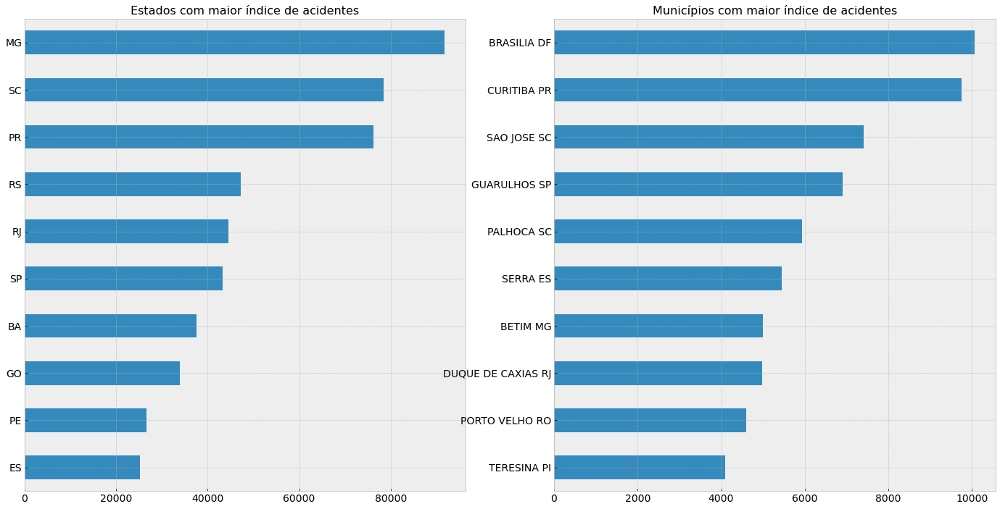

In [25]:
#Municípios e Estados com maior índice de acidentes no período
plt.style.use("bmh")
plt.figure(figsize = (24, 12))

#Estados
plt.subplot(1, 2, 1)
acidentes['uf'].value_counts()[:10].sort_values().plot(kind='barh', fontsize=14)
plt.title("Estados com maior índice de acidentes", fontsize=16)

#Municípios
plt.subplot (1,2,2)
acidentes['municipio'].value_counts()[:10].sort_values().plot(kind='barh', fontsize=14)
plt.title("Municípios com maior índice de acidentes", fontsize=16)

plt.show()

### Acidentes frequentes

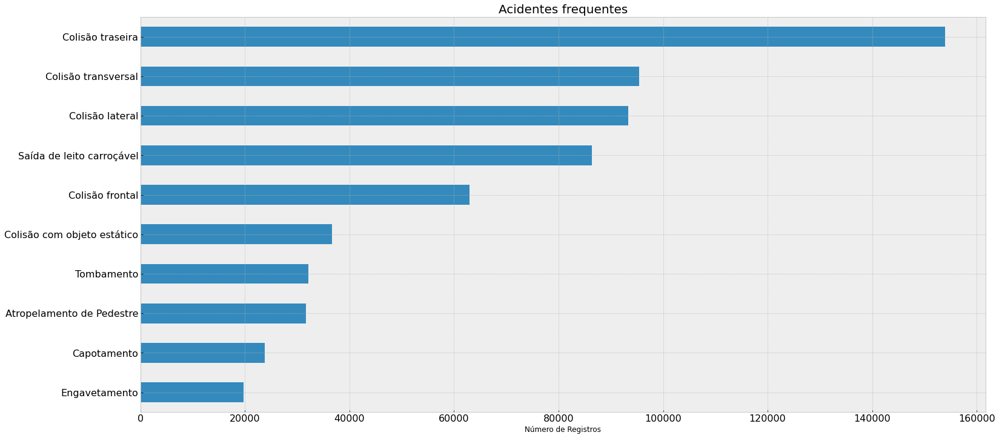

In [26]:
#Acidentes com maiores registros
plt.figure(figsize = (25, 12))
acidentes['tipo_acidente'].value_counts()[:10].sort_values().plot(kind='barh', fontsize=16)
plt.title("Acidentes frequentes", fontsize=20)
plt.xlabel("Número de Registros")
plt.show()

### Principais causas

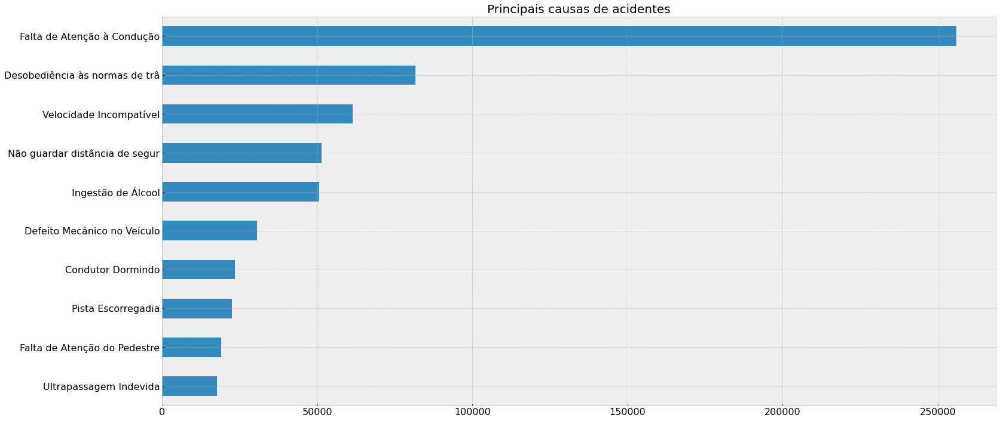

In [27]:
causas = acidentes['causa_acidente'].value_counts()[:10].sort_values()
plt.figure(figsize = (25, 12))
causas.plot(kind='barh', fontsize=16)
plt.title("Principais causas de acidentes", fontsize=20)
plt.ylabel("", fontsize=20)
plt.xlabel('', fontsize=20)
plt.show()

### Registros de acidentes por gênero, fase do dia e classificação do acidente

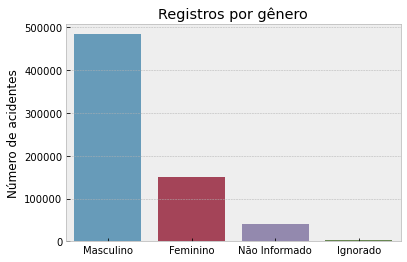

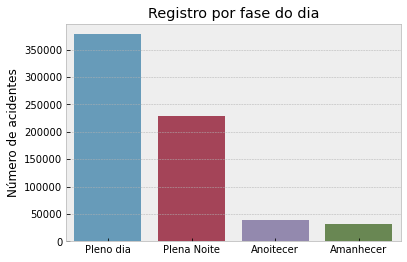

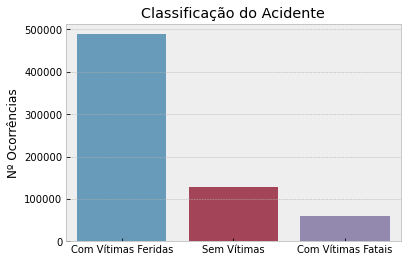

In [28]:
sexo = acidentes['sexo'].value_counts()
plt.figure()
sns.barplot(sexo.index, sexo.values, alpha=0.8)
plt.title('Registros por gênero')
plt.ylabel('Número de acidentes', fontsize=12)
plt.xlabel('', fontsize=12)

fase = acidentes['fase_dia'].value_counts()
plt.figure()
sns.barplot(fase.index, fase.values, alpha=0.8)
plt.title('Registro por fase do dia')
plt.ylabel('Número de acidentes', fontsize=12)
plt.xlabel('', fontsize=12)

clf_acidente = acidentes['classificacao_acidente'].value_counts()
plt.figure()
sns.barplot(clf_acidente.index, clf_acidente.values, alpha=0.8)
plt.title('Classificação do Acidente')
plt.ylabel('Nº Ocorrências', fontsize=12)
plt.xlabel('', fontsize=12)

plt.show()

### Rodovias com maior número de registros de acidentes

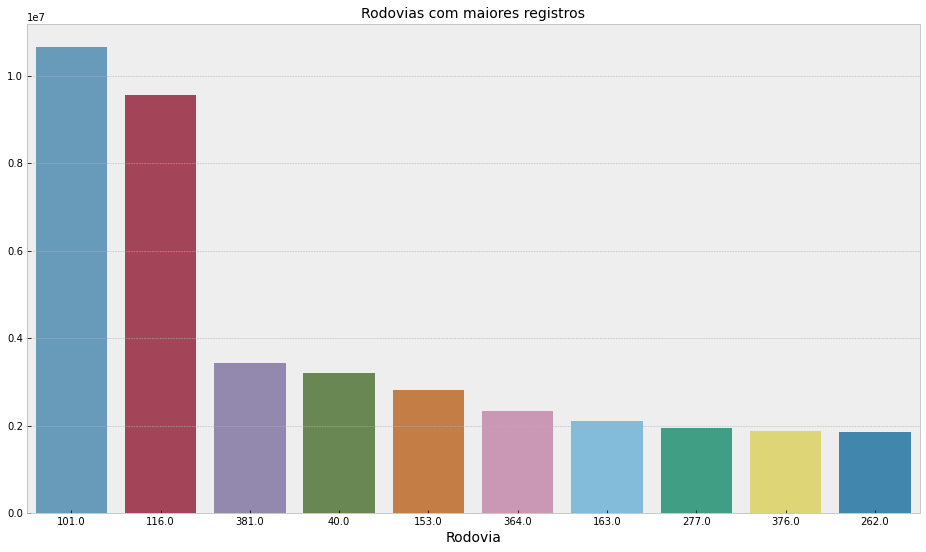

In [29]:
#Rodovias com maiores números de ocorrências de acidentes value_counts(). 
rodovias = acidentes['br'].value_counts(normalize=False).iloc[:10]*100
plt.figure(figsize = (16,9))
sns.barplot(rodovias.index, rodovias.values, alpha=0.8, order=rodovias.index)
plt.title("Rodovias com maiores registros", fontsize=14)
plt.xlabel("Rodovia", fontsize=14)
plt.show()

### Quantidade de registros por dia da semana

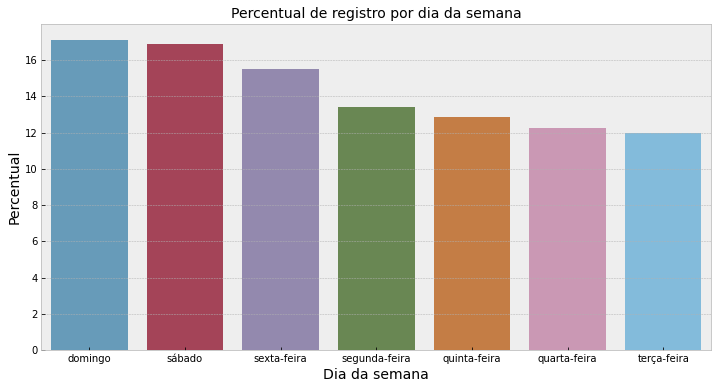

In [30]:
#Dias da semana com maiores números de registros
dia_semana = acidentes['dia_semana'].value_counts(normalize=True)*100
plt.figure(figsize = (12,6))
#dia_semana.plot(kind='bar', fontsize=14)
sns.barplot(dia_semana.index, dia_semana.values, alpha=0.8)
plt.title("Percentual de registro por dia da semana", fontsize=14)
plt.ylabel("Percentual", fontsize=14)
plt.xlabel("Dia da semana", fontsize=14)
plt.show()

### Quantidade de registros por condição meteorológica

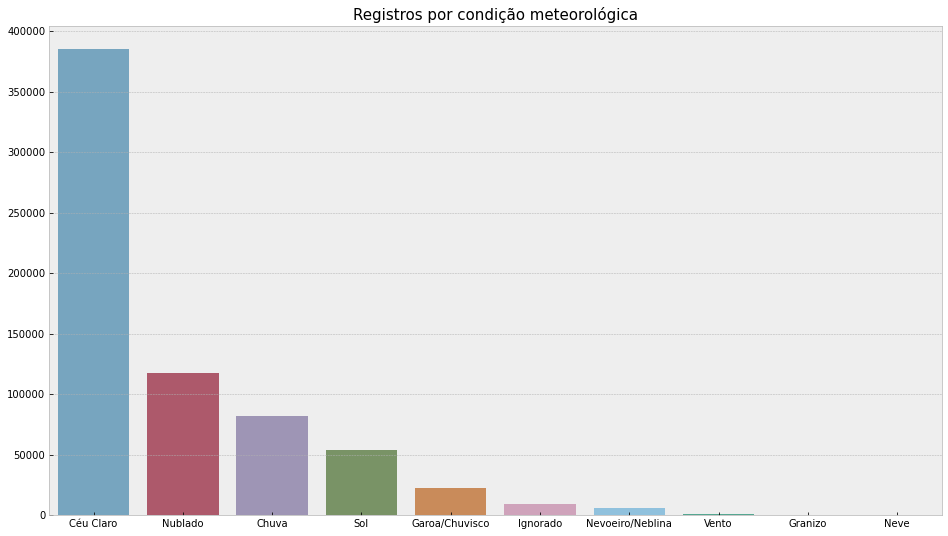

In [31]:
cond_climatica = acidentes['condicao_metereologica'].value_counts()
plt.figure(figsize = (16,9))
sns.barplot(cond_climatica.index, cond_climatica.values, alpha=0.7)
plt.xlabel("")
plt.title("Registros por condição meteorológica", fontsize=15)
plt.xlabel('', fontsize=12)
plt.show()

### Números de acidentes fatais acumulados por estado

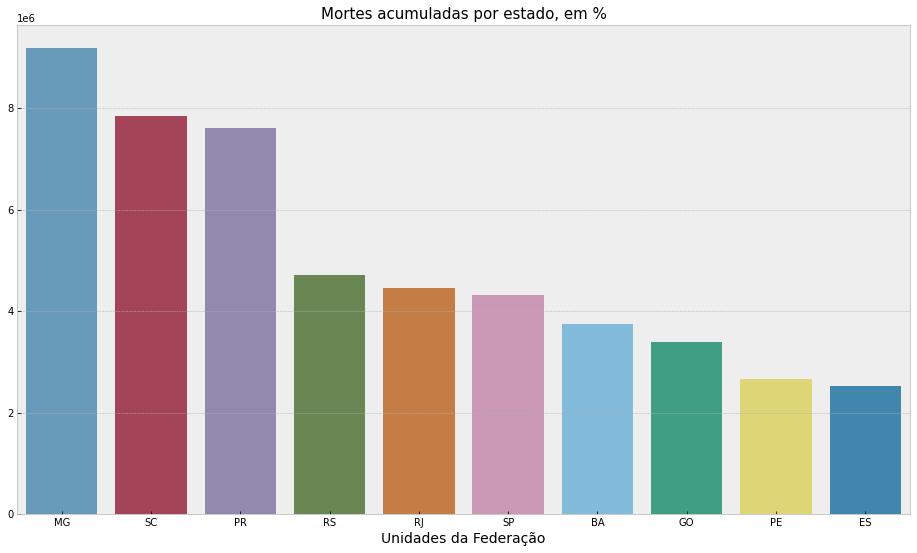

In [32]:
#mortos_estado = acidentes.groupby('uf').sum()
mortos_estado = acidentes['uf'].value_counts().iloc[:10]*100
plt.figure(figsize = (16,9))
sns.barplot(mortos_estado.index, mortos_estado.values, alpha=0.8)
plt.title("Mortes acumuladas por estado, em %", fontsize=15)
plt.xlabel("Unidades da Federação", fontsize=14)
plt.show()

### Mapa de Calor com os locais de maior ocorrência de acidentes

Este mapa de calor apresenta em vermelho as áreas quentes, com maiores índices de ocorrência de acidentes.

In [33]:
latitude = acidentes.latitude.str.replace(',','.').astype('float64').tolist()
longitude = acidentes.longitude.str.replace(',','.').astype('float64').tolist()
mapa = folium.Map(
    width = 700,
    height = 600,
    location=[-15.77972, -47.92972],
    zoom_start=10
)

HeatMap(list(zip(latitude, longitude))).add_to(mapa)
mapa

### Enriquecimento de dados via scraping

A partir dos dados gerados sobre as rodovias que possuem maior número de registros, efetuamos uma busca no Twitter com a finalidade de enriquecer os dados obtidos pela Polícia Rodoviária Federal. Para isso, utilizamos a biblioteca Twint e um script
que se encontra na pasta de nome Twint, junto a este notebook.

In [34]:
rodovias_twitter = rodovias.index.astype('int')
rodovias_twitter

Int64Index([101, 116, 381, 40, 153, 364, 163, 277, 376, 262], dtype='int64')

In [35]:
# Cria uma lista vazia para armazenar os datasets que serão obtidos em cada retorno do laço.
twitter_dataset = []
for i in rodovias_twitter:
 #Concatena o caminho do arquivo gerado pelo script de coleta da Biblioteca Twint
    arquivo = "rodovia_" + str(i)
    path = "C:\\\\Users\\\\valde\\\\OneDrive\\\\TCC PUC\\\\Twint\\\\" + arquivo + "\\\\tweets.csv"
    
    #Utilizando a lib Pandas realiza a leitura dos datasets 
    arquivo = pd.read_csv(path)
    
    #Armazena os datasets em uma lista
    twitter_dataset.append(arquivo)
    

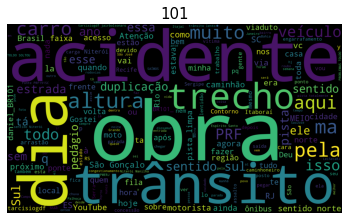

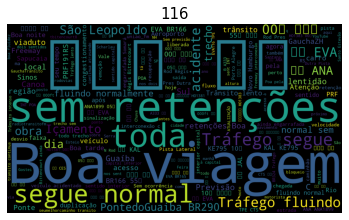

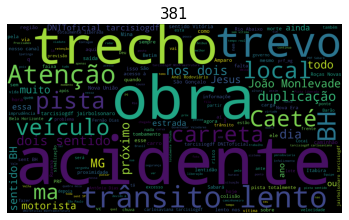

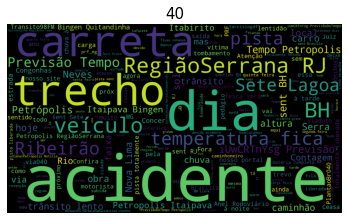

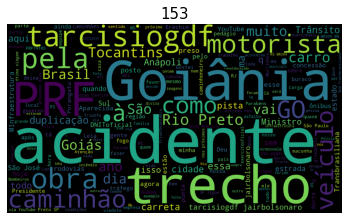

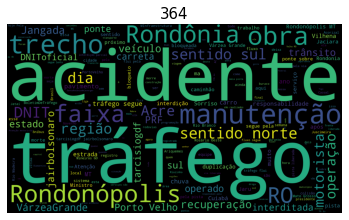

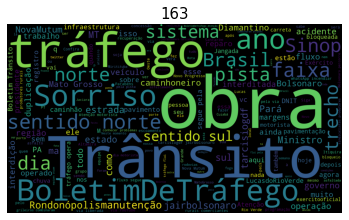

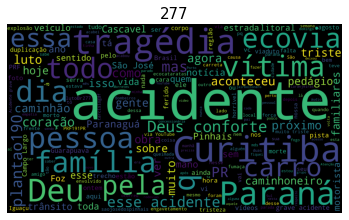

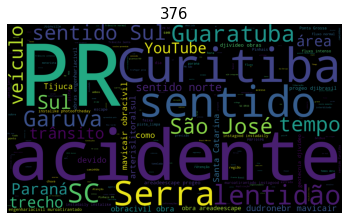

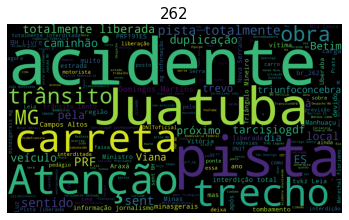

In [36]:
for i in range(len(twitter_dataset)):
    juncao = " ".join(s for s in twitter_dataset[i].tweet)
    stopwords = set(STOPWORDS)
    stopwords.update(["\t", "Saiba", "eu", "vídeo", "bom","plantao_190", "Br381_urgente", "se", "RosárioOeste", "Rosário Oeste", "entre", "Rosario Oeste" "RosárioOeste", "RotadoOesteinforma", "há", "nas", "tem", "rodovia","onde","Rondoniagora","dos", 
                  "o", "siga", "já", "RotadoOeste", "por", "foi", "uma", "para", "da","das", "meu", "em", "você", "de", "ao", 
                  "os", "https", "t", "co", "br", "br364", "e", "na", "que", 'pare', "km", "é", "um","está","br101", "pra", "até", "PRF191MG",
                     "não", "br116", "br381", "br040", "br153", "br163", "br277", "br376", "br262", "mais", "só", "Arteris_ALS"])

    # gerar uma wordcloud
    wordcloud = WordCloud(stopwords=stopwords,
                      background_color="black",
                      width=1920, height=1080).generate(juncao)

    # mostrar a imagem final
    fig, ax = plt.subplots()
    ax.imshow(wordcloud, interpolation='bilinear')
    ax.set_axis_off()

    plt.title(rodovias_twitter[i], fontsize=15)
    plt.imshow(wordcloud);

# Preparação dos modelos de Machine Learning

<img src="ml_map.png">

Com base na documentação da biblioteca Scikitlearn https://scikit-learn.org/stable/tutorial/machine_learning_map/, observamos que trata-se de um problema de classificação, portanto, utilizamos os algoritmos recomendados pela biblioteca.

### Conversão dos dados object para string

A conversão abaixo busca, normalizar os dados para facilitar o trabalho com modelos de Aprendizado de Maquina que lidam com dados categóricos

In [37]:
datatypes_per_column = {
                   'uf': "string",
                   'br': "string",
                   'km': "string",
                    'municipio': "string",
                    'causa_acidente':"string",
                    'tipo_acidente':"string",
                    'fase_dia':"string",
                    'condicao_metereologica':"string",
                    'tipo_pista':"string",
                    'tracado_via':"string",
                    'mortos': "int64"
       }
  
acidentes = acidentes.astype(datatypes_per_column)

### Conversão da coluna de acidentes com vítimas fatais

Com o objetivo de padronizar os algoritmos de previsão, procedi a transformação da coluna de vítimas fatais para um formato binário, onde, acidentes sem vítimas fatais assumem o valor 0 e com vítimas fatais assumem o valor 1

In [38]:
#Função que converte a colunas mortos para valores binários, 1 para a acidentes com mortos e 0 para acidentes sem mortos.
def to_bin (x):
    if x >= 1:
        return 1
    else:
        return 0

In [39]:
acidentes.mortos = acidentes.mortos.map(to_bin)

### Remoção da coluna classificação de acidentes

Optei por remover a coluna **classificacao_acidente** pois a mesma continha a informação que o algortimo iria prever, pois onde houvesse o registro de Vítimas Fatais haveria consequentemente um registro de mortos.

In [40]:
acidentes.classificacao_acidente.value_counts()

Com Vítimas Feridas    488809
Sem Vítimas            128798
Com Vítimas Fatais      60147
Name: classificacao_acidente, dtype: int64

In [41]:
acidentes = acidentes.drop(columns=['classificacao_acidente'])

In [42]:
acidentes = acidentes.drop(columns=['data_inversa'])

### Divisão do Dataset entre previsores e classe a ser prevista

In [43]:
previsores = acidentes.drop(['mortos'], axis=1, inplace=False)
classe = acidentes['mortos']

### Transformação da classe previsora

In [44]:
categoricas = ['uf', 'br', 'km', 'municipio', 'causa_acidente', 'tipo_acidente',
       'fase_dia', 'condicao_metereologica', 'tipo_pista', 'tracado_via']
numericas = ['mortos']

ct = make_column_transformer(
      (StandardScaler(),
       make_column_selector(dtype_include=np.number)),
      (OneHotEncoder(drop='if_binary'), categoricas,
       make_column_selector(dtype_include=object))) 

In [45]:
previsores = ct.fit_transform(previsores)

### Pré-processamento da classe alvo

In [46]:
#Instanciamento da classe de modificação de rótulos
le = LabelEncoder()

In [47]:
classe = le.fit_transform(classe)

In [48]:
#classe_teste = le.fit_transform(classe_teste)

### Divisão do Dataset para treino e teste dos algoritmos

In [49]:
previsores_treino, previsores_teste, classe_treino, classe_teste = train_test_split(previsores, classe)
previsores_treino.shape, previsores_teste.shape

((508315, 11843), (169439, 11843))

### Desbalanceamento da base de dados

Apliquei o Aprendizado de Máquina com a base em sua forma de origem, com o objetivo de  analisar o comportamento do aprendizado, mesmo tendo a ciência de que os dados de registros estão desbalanceados, e por isso, afetam sensivelmente o resultado do algoritmo.

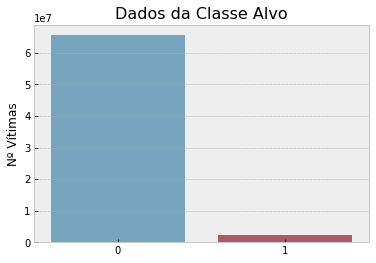

In [50]:
per_mortes = acidentes['mortos'].value_counts(normalize=False)*100
sns.barplot(x=per_mortes.index, y=per_mortes.values, alpha=0.7)
plt.ylabel('Nº Vítimas', fontsize=12)
plt.title("Dados da Classe Alvo", fontsize=16)
plt.show()

# Algoritmos de Aprendizado de Máquina - Dados Originais


## SVM - Suport Vector Machine - Dados Originais

In [51]:
C = 1.0  # SVM regularization parameter
clf = svm.SVC(kernel='linear', C=C)

In [52]:
clf.fit(previsores_treino, classe_treino)

SVC(kernel='linear')

In [53]:
clf.predict(previsores_teste)

array([0, 0, 0, ..., 0, 1, 0], dtype=int64)

In [54]:
predict_svm = clf.predict(previsores_teste)

In [55]:
clf.score(previsores_teste, classe_teste)

0.9748818158747395

### Matriz de confusão SVM com kernel linear - dados originais

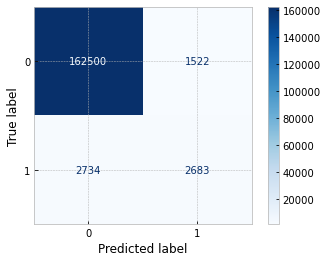

In [56]:
matriz_svm = plot_confusion_matrix(clf, previsores_teste, classe_teste, cmap='Blues', values_format='d')

### Classificação SVM com kernel linear - dados originais

In [57]:
print(classification_report(classe_teste, predict_svm))

              precision    recall  f1-score   support

           0       0.98      0.99      0.99    164022
           1       0.64      0.50      0.56      5417

    accuracy                           0.97    169439
   macro avg       0.81      0.74      0.77    169439
weighted avg       0.97      0.97      0.97    169439



## Decision Tree  - Dados Originais

In [58]:
clf_arvore = tree.DecisionTreeClassifier()

In [59]:
tree_classificador = clf_arvore.fit(previsores_treino, classe_treino)

In [60]:
tree_previsor = tree_classificador.predict(previsores_teste)

In [61]:
acuracia_tree = tree_classificador.score(previsores_teste, classe_teste)
acuracia_tree

0.9965297245616417

### Matriz de confusão Decision Tree - dados originais

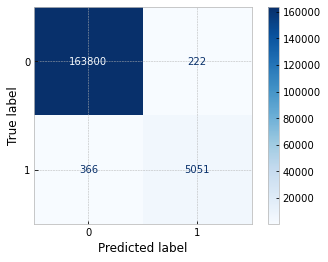

In [62]:
desb_disp_classificador = plot_confusion_matrix(tree_classificador, previsores_teste, classe_teste, cmap='Blues', values_format='d')

### Classificação Árvore de Decisão

In [63]:
desb_report = print(classification_report(classe_teste, tree_previsor))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    164022
           1       0.96      0.93      0.94      5417

    accuracy                           1.00    169439
   macro avg       0.98      0.97      0.97    169439
weighted avg       1.00      1.00      1.00    169439



## Random Forest Classifier - Dados Originais

In [64]:
RandomFC = RandomForestClassifier(n_estimators = 100)
model_rf = RandomFC.fit(previsores_treino, classe_treino) 

In [65]:
print(cross_val_score(model_rf, previsores_teste, classe_teste, cv = 10)) 
pred = model_rf.predict(previsores_teste)
print('Accuracy of ', accuracy_score(pred, classe_teste)*100)

[0.97279273 0.97232059 0.97338291 0.97255666 0.97119924 0.9713763
 0.97208451 0.97261568 0.97173041 0.97237797]
Accuracy of  97.57080719314915


### Matriz de confusão Randon Forest - dados originais

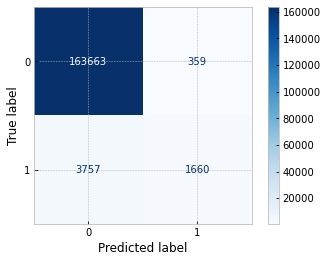

In [66]:
RandomFC_classificador = plot_confusion_matrix(model_rf, previsores_teste, classe_teste, cmap='Blues', values_format='d')

### Classificação Random Forest

In [67]:
print(classification_report(classe_teste, pred))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99    164022
           1       0.82      0.31      0.45      5417

    accuracy                           0.98    169439
   macro avg       0.90      0.65      0.72    169439
weighted avg       0.97      0.98      0.97    169439



## Balanceamento do Dataset com técnica de oversampling

In [68]:
over_sampling = SMOTE()

In [69]:
previsores_teste_bal, classe_teste_bal = over_sampling.fit_sample(previsores_teste, classe_teste)

In [70]:
previsores_treino_bal, classe_treino_bal = over_sampling.fit_sample(previsores_teste, classe_teste)

# Algoritmos de Aprendizado de Máquina - Dados Balanceados

## Decision Tree  - Dados Balanceados

In [71]:
clf_arvore = tree.DecisionTreeClassifier()

In [72]:
tree_classificador = clf_arvore.fit(previsores_treino_bal, classe_treino_bal)

In [73]:
tree_previsor = tree_classificador.predict(previsores_teste_bal)

In [74]:
acuracia_tree = tree_classificador.score(previsores_teste_bal, classe_teste_bal)
acuracia_tree

0.9998170977064053

### Matriz de confusão Decision Tree - balanceada

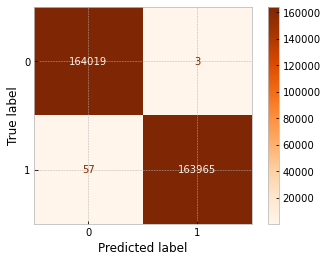

In [75]:
disp_classificador = plot_confusion_matrix(tree_classificador, previsores_teste_bal, classe_teste_bal, cmap='Oranges', values_format='d')

### Classificação Árvore de Decisão

In [76]:
print(classification_report(classe_teste_bal, tree_previsor))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    164022
           1       1.00      1.00      1.00    164022

    accuracy                           1.00    328044
   macro avg       1.00      1.00      1.00    328044
weighted avg       1.00      1.00      1.00    328044



## SVM - Suport Vector Machine - Dados Balanceados

In [77]:
clf.fit(previsores_treino_bal, classe_treino_bal)

SVC(kernel='linear')

In [78]:
clf.predict(previsores_teste_bal)

array([0, 0, 0, ..., 1, 1, 1], dtype=int64)

In [79]:
predict_svm = clf.predict(previsores_teste_bal)

In [80]:
clf.score(previsores_teste_bal, classe_teste_bal)

0.9888460084622794

### Matriz de confusão SVM linear - balanceada

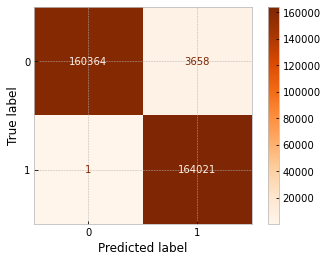

In [81]:
matriz_svm_bal = plot_confusion_matrix(clf, previsores_teste_bal, classe_teste_bal, cmap='Oranges', values_format='d')

### Classificação SVM com kernel linear - dados originais

In [82]:
print(classification_report(classe_teste_bal, predict_svm))

              precision    recall  f1-score   support

           0       1.00      0.98      0.99    164022
           1       0.98      1.00      0.99    164022

    accuracy                           0.99    328044
   macro avg       0.99      0.99      0.99    328044
weighted avg       0.99      0.99      0.99    328044



## Random Forest Classifier - Dados Balanceados

In [83]:
model_rf = RandomFC.fit(previsores_treino_bal, classe_treino_bal) 

In [84]:
print(cross_val_score(model_rf, previsores_teste_bal, classe_teste_bal, cv = 10)) 
pred = model_rf.predict(previsores_teste_bal)
print('Accuracy of ', accuracy_score(pred, classe_teste_bal)*100)

[0.93994818 0.99878067 0.99887212 0.99881116 0.9988416  0.9984758
 0.99844531 0.99881112 0.99896354 0.9988416 ]
Accuracy of  99.98780651376035


### Matriz de confusão Randon Forest - dados balanceados

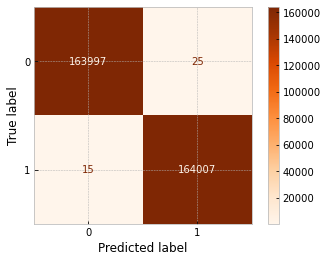

In [85]:
RandomFC_classificador = plot_confusion_matrix(model_rf, previsores_teste_bal, classe_teste_bal, cmap='Oranges', values_format='d')

### Classificação Random Forest - dados balanceados

In [86]:
print(classification_report(classe_teste_bal, pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    164022
           1       1.00      1.00      1.00    164022

    accuracy                           1.00    328044
   macro avg       1.00      1.00      1.00    328044
weighted avg       1.00      1.00      1.00    328044



## Conclusão dos resultados 

É evidente o quanto o desbalanceamento exerceu influência sobre o conjunto de treino e de teste. Especialmente nos algoritmos de Random Forest e SVM Linear, muito embora na primeira árvore de decisão tenhamos alcançado bons resultados mesmo com os dados desbalanceados.